## Table of Contents

1. [Enviroment setup](#env-setup)
2. [Load and process images](#data-loading)
3. [Algorithm implementation](#algorithm-implementation)
   1. [Sum of the modified laplacian](#31-sgml-sum-of-the-modified-laplacian)
   2. [Strategy of initial segmentation](#32-strategy-of-initial-segmentation)
   3. [Image matting technique for fusion](#33-image-matting-technique-for-fusion)

<a id="env-setup"></a>
# 1. Workspace Setup

## Downloading MFIF dataset

- To facilitate easy access to the required dataset for the image processing algorithm, we provide a shell script that automates the download and setup process
- In order for data to be downloaded uncomment and run the cell below

In [196]:
# !./load_data.sh 

## Enviroment Setup

- Open a terminal in this working directory and create a conda enviroment using:  
```bash
conda env create -f environment.yml
```

- All packages required to run this project shall be installed using pip as follows:
```bash
pip install -r requirements.txt
```

<a id="data-loading"></a>
# 2. Load and process images

* Import the neccesary libraries to run this project
* Define a **path variable** that points towards the data directory that is created through the **.sh** script. 
* Create a class that handless the proces of retrieving paths to images from the data directory
* Use the paths to load and process images using <code>cv2</code>

In [197]:
from pathlib import Path
import os
import cv2 as cv
import numpy as np

import pandas as pd


import const

import matplotlib.pyplot as plt

In [198]:
class DataFolder:
    """
    This class is a wrapper for the folder containing images for the muti-focus fusion task.
    The folder contains a set of subfolders, each of which contains 2 images with opposite focus.
    """

    def __init__(self, path: Path):
        self.path = path

    def get_images(self, folder_name:str=None) -> np.ndarray[Path]:
        """
        Get the images from the specified folder_name. 
        If no name is provided the a random pair of images from the data folder are selected.
        """
        if folder_name is None:
            folder = self.path / np.random.choice(os.listdir(self.path))
        else:
            folder = self.path / folder_name
            
        img_paths = []
        for img in sorted(Path(folder.as_posix()).glob("*.jpg")):
            img_paths.append(img)

        return np.array(img_paths)

In [199]:
def process_images(img_paths: np.ndarray[Path]) -> np.ndarray:
    """
    Process a pair of images: convert to RGB color channels.
    """
    imgs = []
    for img_path in img_paths:
        img = cv.imread(img_path.as_posix())
        img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
        imgs.append(img)

    return np.array(imgs)

In [200]:
def plot_images(images: np.ndarray, titles: list[str] = ["Img1", "Img2"]):
    """
    Plot a pair of images.
    """
    # create a figure with two subplots
    if images.ndim == 2:
        plt.figure()
        plt.imshow(images, cmap="gray")
        plt.title(titles[0])
        plt.show()
        return
    
    fig, axes = plt.subplots(1, 2, figsize=(15, 15))
    for i, ax in enumerate(axes):
        if images[i].ndim == 2:
            ax.imshow(images[i], cmap="gray")
        else:
            ax.imshow(images[i])
        if titles:
            ax.set_title(titles[i])
        ax.axis("off")
        ax.set_yticks([])
    plt.show()

Data directory located at: 
	/home/astanea/code/image_processing/Image-Processing/data
Selecting images from the following paths:
	/home/astanea/code/image_processing/Image-Processing/data/MFI-WHU_05/MFI-WHU_05_A.jpg
	/home/astanea/code/image_processing/Image-Processing/data/MFI-WHU_05/MFI-WHU_05_B.jpg
Processed images with shape: (2, 427, 640, 3)
	Num images: 2
	Height: 427
	Width: 640
	Num channels: 3


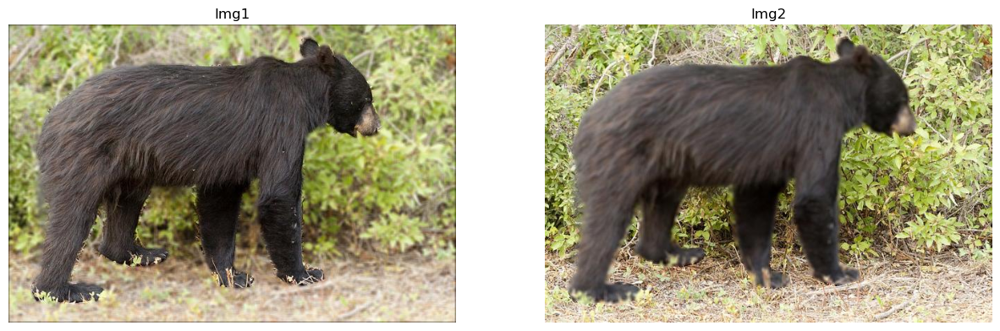

In [201]:
DATA_DIR = Path.cwd() / "data"
print(f"Data directory located at: \n\t{DATA_DIR.as_posix()}")

data_folder = DataFolder(DATA_DIR)

# images = data_folder.get_images('mffw_07')
images = data_folder.get_images()
print("Selecting images from the following paths:")
for img in images:
    print(f"\t{img}")

images = process_images(images)
print(f"Processed images with shape: {images.shape}")
for descriptor, value in zip(
    ["Num images", "Height", "Width", "Num channels"], images.shape
):
    print(f"\t{descriptor}: {value}")

plot_images(images)

<a id="algorithm-implementation"></a>

# 3. Algorithm implementation

## 3.1. SGML: Sum of the modified Laplacian

-  The proposed method: SGML is used to solve the task of image fusion wich consist in the combination of multiple images with different focus depths into a single all-in-focus image.
-  **SGML** is an advanced focus measure, whihch enhances the capabilities of previous SML implementation. The primary advantage is represented by its superior ability to distinghuis focus regions from defocused ones, especially in areas with low contrast.


In [202]:
def plot_kernel_1D(kernel):
    plt.figure()
    plt.plot(kernel)
    plt.title("Representation of 1D Gaussian Kernel")
    plt.xlabel("Index")
    plt.ylabel("Kernel Value")
    plt.show()

In [203]:
def plot_kernel_2D(kernel):
    # Create the x and y coordinate arrays
    x = np.arange(kernel.shape[0])
    y = np.arange(kernel.shape[1])
    x, y = np.meshgrid(x, y)

    # Create the figure
    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")

    # Plot the surface
    ax.plot_surface(x, y, kernel, cmap="viridis")

    # Labels and title
    ax.set_xlabel("X axis")
    ax.set_ylabel("Y axis")
    ax.set_zlabel("Kernel Value")
    ax.set_title("3D Representation of 2D Gaussian Kernel")

    # Show the plot
    plt.show()

- The Gaussian kernel provides a weighted average where pixels closer to the central pixel have higher weights than those further away. This weighted averaging is more effective in preserving important image features while reducing noise, as opposed to a simple average where every pixel has equal weight
- The Gaussian kernel tends to preserve edges better than other types of blurring. This property makes is usefull in applications such as edge detection and image segmentation.
- Having a gaussian distribution, the sum of the weights always add up to 1.

In [204]:
gaussian_kernel_1D = cv.getGaussianKernel(const.KERNEL_SIZE, 
                                          const.SIGMA)
gaussian_kernel_2D = np.outer(gaussian_kernel_1D,
                              gaussian_kernel_1D.transpose())

print(f"gaussian_kernel_1D shape: {gaussian_kernel_1D.shape}")
print(np.sum(gaussian_kernel_1D))
print(gaussian_kernel_1D)
print(f"gaussian_kernel_2D shape: {gaussian_kernel_2D.shape}")
print(np.sum(gaussian_kernel_2D))
print(gaussian_kernel_2D)

gaussian_kernel_1D shape: (7, 1)
0.9999999999999999
[[0.07015933]
 [0.13107488]
 [0.19071282]
 [0.21610594]
 [0.19071282]
 [0.13107488]
 [0.07015933]]
gaussian_kernel_2D shape: (7, 7)
0.9999999999999999
[[0.00492233 0.00919613 0.01338028 0.01516185 0.01338028 0.00919613
  0.00492233]
 [0.00919613 0.01718062 0.02499766 0.02832606 0.02499766 0.01718062
  0.00919613]
 [0.01338028 0.02499766 0.03637138 0.04121417 0.03637138 0.02499766
  0.01338028]
 [0.01516185 0.02832606 0.04121417 0.04670178 0.04121417 0.02832606
  0.01516185]
 [0.01338028 0.02499766 0.03637138 0.04121417 0.03637138 0.02499766
  0.01338028]
 [0.00919613 0.01718062 0.02499766 0.02832606 0.02499766 0.01718062
  0.00919613]
 [0.00492233 0.00919613 0.01338028 0.01516185 0.01338028 0.00919613
  0.00492233]]


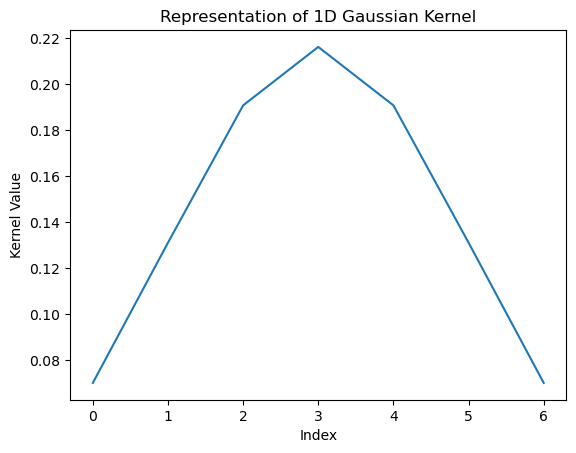

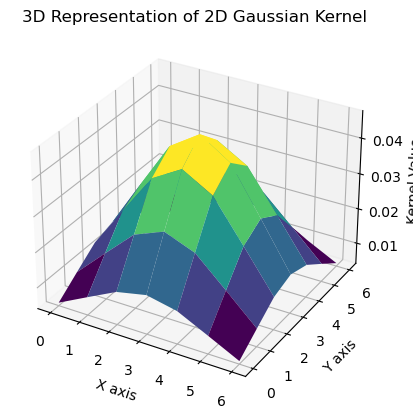

In [205]:
plot_kernel_1D(gaussian_kernel_1D)
plot_kernel_2D(gaussian_kernel_2D)

### Utility methods

- **Padding:**

    When applying the convolution operation, the edges of the original image get shrunk. In order to preserve the original size, we add zeros around the borders to compensate for the size loss.

- **Convolution Operation:**

    Given an image of size $W \times H$ ($W$ - width and $H$ - height) and a square kernel of size $k \times k$, the size of the output image after applying the kernel will be $(W - k + 1) \times (H - k + 1)$.

NOTE: 
* The custom convolution allows us to manipulate the operation at every step by giving acces to the X and Y coordinates, as well as the current patch of the original image. Custom logic can be then applied if we want to use only certain pixels. In case we want to do a normal convolution, then we would do a dot product with the desired kernel.
* Also notice that we only implement the convolution operation on the valid pixel locations from the original image. In order to be correct mathematically the border should be cropped. 

In [206]:
def pad_images(images: np.ndarray, padding: int, border=cv.BORDER_CONSTANT):
    """Takes a list of images and pads them with zeros

    Args:
        images (np.ndarray): list containing images to be padded as numpy arrays
        padding (int): padding to be applied to each image. This is the number of pixels to be added to each individual side of the image.

    Returns:
        np.ndarray: padded images
    """
    padded_images = []

    for idx, img in enumerate(images):
        replicate = cv.copyMakeBorder(
            img, padding, padding, padding, padding, border, value=0
        )
        padded_images.append(replicate)

    return np.array(padded_images)

In [207]:
def convolution_iterator(img: np.ndarray, kernel: np.ndarray, verbose=False):
    """_summary_

    Args:
        img (np.ndarray): Input image
        kernel (np.ndarray): Size of the kernel
        verbose (bool, optional): Log extra information . Defaults to False.

    Yields:
        _type_: _description_
    """
    height_img, width_img = img.shape
    height_kernel, width_kernel = kernel.shape

    if verbose:
        print(f"\t\tkernel_shape: {kernel.shape}")
        print(f"\t\timg shape: {img.shape}")
        print(f"\t\ty_start (IDX) = {(height_kernel // 2) -1}")
        print(f"\t\ty_end (IDX) = {(height_img - height_kernel // 2) -1}")
        print(f"\t\tx_start (IDX) = {(width_kernel // 2 -1) -1}")
        print(f"\t\tx_end (IDX) = {(width_img - width_kernel // 2) -1}")
        print(f"\t\twindow shape: {(height_kernel, width_kernel)}")

    # Loop through each pixel in the image skipping the outer edges of the image
    for row in range(height_kernel // 2, height_img - height_kernel // 2):
        for col in range(width_kernel // 2, width_img - width_kernel // 2):
            window = img[
                row - height_kernel // 2: row + height_kernel // 2 + 1,
                col - width_kernel // 2: col + width_kernel // 2 + 1,
            ]
            yield (row, col, window)

In [208]:
def ML(images, kernel_size, step_size=1, verbose=False):
    kernel = np.ones((kernel_size, kernel_size))

    if verbose:
        print(f"\tkernel shape: {kernel.shape}")
        print(f"\tstep_size: {step_size}")

    ml_images = []
    for idx, img in enumerate(images):
        crnt_ml = np.zeros_like(img)
        for row, col, _ in convolution_iterator(img, kernel, verbose):
            crnt_ml[row, col] = np.abs(
                2 * img[row, col] - img[row - step_size, col] - img[row + step_size, col]
            )
            +np.abs(2 * img[row, col] - img[row, col - step_size] -
                    img[row, col + step_size])
        ml_images.append(crnt_ml)
    return np.array(ml_images)

In [209]:
def SGML(ml_images, crop_size, kernel, verbose=False):
    threshold=0
    
    if verbose:
        print(f"\tgaussian_kernel_2D shape: {kernel.shape}")
        print(f"Gaussina kernel: {kernel}")
    
    # sgml_images = []
    # for img in ml_images:
    #     crnt_img = np.zeros_like(img)
    #     for row, col, window in convolution_iterator(img, kernel, verbose):
    #         # mask = window > threshold
    #         # crnt_step = np.where(mask, window*kernel, 0)
    #         crnt_img[row, col] = np.sum(window*kernel)
    #         # print(window)
    #         # print(row, col)
    #     sgml_images.append(crnt_img[crop_size:-crop_size, crop_size:-crop_size])
        
    sgml_images = []
    for img in ml_images:
        crnt_img = np.zeros_like(img)
        for row, col, window in convolution_iterator(img, gaussian_kernel_2D):
            crnt_img[row, col] = np.sum(window*gaussian_kernel_2D)
        sgml_images.append(crnt_img[3:-3, 3:-3])
        
    return np.array(sgml_images)
    

In [210]:
print(f"Kernel size is: {const.KERNEL_SIZE}")
print(f"Padding neede do keep same image dimensions: {const.PADDING}")

grayscale_imgages = np.array(
    [cv.cvtColor(img, cv.COLOR_BGR2GRAY) for img in images])

padded_images = pad_images(images=grayscale_imgages,
                           padding=const.PADDING,
                           border=cv.BORDER_CONSTANT)
# 255 - ML to obtain the negative of the image
ml_images = ML(images=padded_images, 
               kernel_size=const.KERNEL_SIZE,
               verbose=const.VERBOSE)
sgml_images = SGML(ml_images=ml_images,
                   crop_size=const.PADDING,
                   kernel=gaussian_kernel_2D,
                   verbose=const.VERBOSE)
print(f"Images shape before padding: {grayscale_imgages.shape}")
print(f"Images shape after padding: {padded_images.shape}")
print(f"Images shape after ML: {ml_images.shape}")
print(f"Images shape after SGML: {sgml_images.shape}")

Kernel size is: 7
Padding neede do keep same image dimensions: 3
	kernel shape: (7, 7)
	step_size: 1
		kernel_shape: (7, 7)
		img shape: (433, 646)
		y_start (IDX) = 2
		y_end (IDX) = 429
		x_start (IDX) = 1
		x_end (IDX) = 642
		window shape: (7, 7)


		kernel_shape: (7, 7)
		img shape: (433, 646)
		y_start (IDX) = 2
		y_end (IDX) = 429
		x_start (IDX) = 1
		x_end (IDX) = 642
		window shape: (7, 7)
	gaussian_kernel_2D shape: (7, 7)
Gaussina kernel: [[0.00492233 0.00919613 0.01338028 0.01516185 0.01338028 0.00919613
  0.00492233]
 [0.00919613 0.01718062 0.02499766 0.02832606 0.02499766 0.01718062
  0.00919613]
 [0.01338028 0.02499766 0.03637138 0.04121417 0.03637138 0.02499766
  0.01338028]
 [0.01516185 0.02832606 0.04121417 0.04670178 0.04121417 0.02832606
  0.01516185]
 [0.01338028 0.02499766 0.03637138 0.04121417 0.03637138 0.02499766
  0.01338028]
 [0.00919613 0.01718062 0.02499766 0.02832606 0.02499766 0.01718062
  0.00919613]
 [0.00492233 0.00919613 0.01338028 0.01516185 0.01338028 0.00919613
  0.00492233]]
Images shape before padding: (2, 427, 640)
Images shape after padding: (2, 433, 646)
Images shape after ML: (2, 433, 646)
Images shape after SGML: (2, 427, 640)


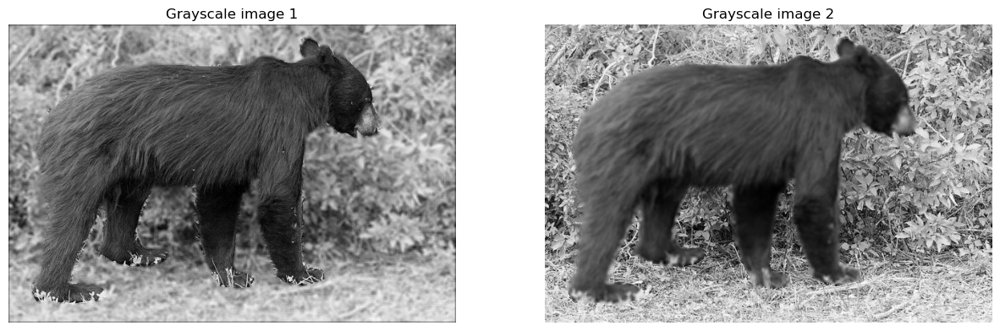

In [211]:
plot_images(grayscale_imgages, ["Grayscale image 1", "Grayscale image 2"])

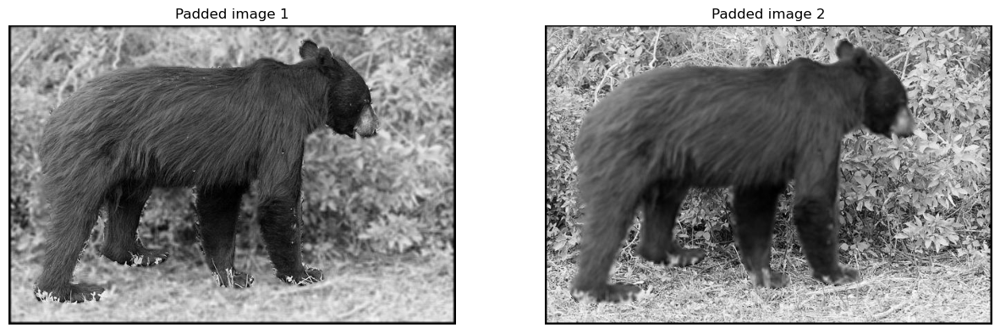

In [212]:
plot_images(padded_images, ["Padded image 1", "Padded image 2"])

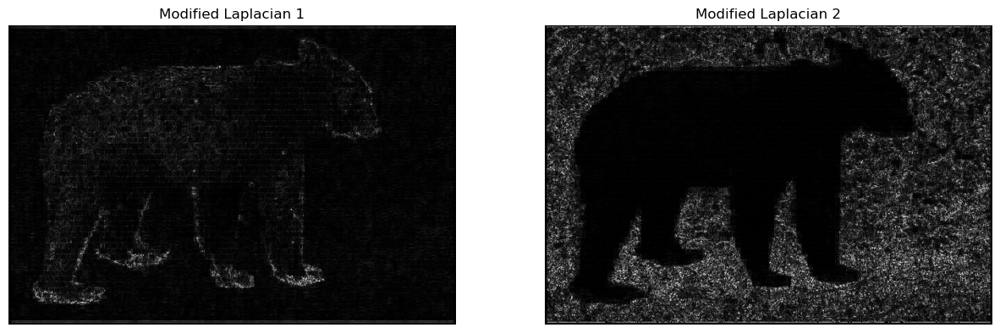

In [213]:
plot_images(ml_images, ["Modified Laplacian 1", "Modified Laplacian 2"]) # show the negative of the image for better visualization

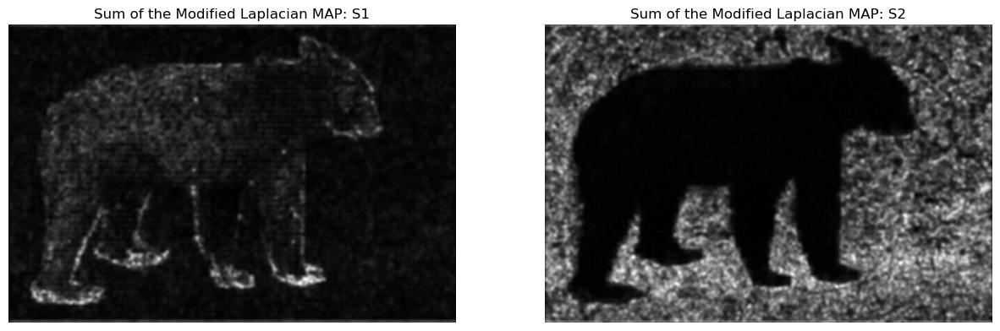

In [214]:
plot_images(sgml_images, ["Sum of the Modified Laplacian MAP: S1", "Sum of the Modified Laplacian MAP: S2"])

## 3.2. Strategy of initial segmentation

- After running the SGML algorithm we obtain the focus maps denoted as S1 and S2. To obtain the decision map that determines which are the focused areas, we use a sliding window strategy 

In [215]:
focus_maps = sgml_images.copy()
print(f"focus_maps shape: {focus_maps.shape}")

focus_maps shape: (2, 427, 640)


In [216]:
def compute_focus_scores(focus_maps: np.ndarray, n=8, step_size=1, verbose=False):
    """_summary_

    Args:
        focus_maps: _description_
        n: Patch size. Defaults to 8 as proposed in the paper.
        step_size: The number of pixels we move the sliding window after each computation.
        verbose: Debug prints.

    Returns:
        _type_: _description_
    """
    # Meta info
    H, W = focus_maps[0].shape
    Q = 0  # number of patches

    # Algorithm parameters
    focus_scores = np.zeros_like(focus_maps)  # F1, F2 maps
    S1, S2 = focus_maps

    # Sliding window over the image
    for y in range(n // 2, H - n // 2 + 1, step_size):
        for x in range(n // 2, W - n // 2 + 1, step_size):
            window1 = S1[
                y - n // 2 : y + n // 2,
                x - n // 2 : x + n // 2,
            ]
            window2 = S2[
                y - n // 2 : y + n // 2,
                x - n // 2 : x + n // 2,
            ]

            Q = Q + 1

            k1 = np.sum(window1)
            k2 = np.sum(window2)

            if k1 > k2:
                focus_scores[0][
                    y - n // 2 : y + n // 2,
                    x - n // 2 : x + n // 2,
                ] += 1
            if k2 > k1:
                focus_scores[1][
                    y - n // 2 : y + n // 2,
                    x - n // 2 : x + n // 2,
                ] += 1
            if k1 == k2:
                focus_scores[0][
                    y - n // 2 : y + n // 2,
                    x - n // 2 : x + n // 2,
                ] += 1
                focus_scores[1][
                    y - n // 2 : y + n // 2,
                    x - n // 2 : x + n // 2,
                ] += 1
            
            # if k1 > k2:
            #     focus_scores[0][
            #         y - n // 2 : y + n // 2,
            #         x - n // 2 : x + n // 2,
            #     ] = 1
            # if k2 > k1:
            #     focus_scores[1][
            #         y - n // 2 : y + n // 2,
            #         x - n // 2 : x + n // 2,
            #     ] = 1

            # if k1 > k2:
            #     focus_scores[0][y, x] += 1
            # if k2 > k1:
            #     focus_scores[1][y, x] += 1

        if y == n // 2 and verbose:
            print(f"window1.shape: {window1.shape}")
            print(f"window2.shape: {window2.shape}")

    if verbose:
        print(compute_focus_scores.__name__)
        print(f"y_start = {n // 2}")
        print(f"y_stop = {H - n // 2 + 1}")
        print(f"x_start = {n // 2}")
        print(f"x_stop = {W - n // 2 + 1}")
        print(f"\tInput image dimensions: H x W = {H} x {W}")
        print(f"\tNumber of patches: {Q}")
        print(
            f"\tTheoretical number of patches: (H-n+1)x(W-n+1) = {(H-n+1)}x{(W-n+1)} = {((H-n+1))*(W-n+1)}"
        )
        print(f"\tFocus scores shape: {focus_scores.shape}")
        print(f"F1 == 0 : {np.sum(focus_scores[0] == 0)}")
        print(f"F1 != 0 : {np.sum(focus_scores[0] != 1)}")
        print(f"F2 == 0 : {np.sum(focus_scores[1] == 0)}")
        print(f"F2 != 0 : {np.sum(focus_scores[1] != 1)}")

    return focus_scores

In [217]:
def compute_initial_segmentation_maps(focus_scores, verbose=False):

    I1_IDX, I2_IDX = range(2)
    
    segmentation_maps = np.ones_like(focus_scores) * 0.5
    F1, F2 = focus_scores
    H, W = focus_maps[0].shape
    
    
    for y in range(H): 
        for x in range(W): 
            if F2[y, x] == 0:
                segmentation_maps[I1_IDX, y, x] = 1
                segmentation_maps[I2_IDX, y, x] = 0
            elif F1[y, x] == 0:
                segmentation_maps[I1_IDX, y, x] = 0
                segmentation_maps[I2_IDX, y, x] = 1
             
    if verbose:
        print(compute_initial_segmentation_maps.__name__)   
        print(segmentation_maps[0])
        print(f"\tW={W}, H={H}")
        print(f"F1.shape: {F1.shape}")
        print(f"F2.shape: {F2.shape}")
        print(f"segmentation_maps shape: {segmentation_maps.shape}")
        print(f"\tFocus scores shape: {focus_scores.shape}")
        print(f"I1 == 0 : {np.sum(segmentation_maps[0] == 0)}")  
        print(f"I1 == 0.5 : {np.sum(segmentation_maps[0] == 0.5)}")
        print(f"I1 == 1 : {np.sum(segmentation_maps[0] == 1)}")
        print(f"I2 == 0 : {np.sum(segmentation_maps[1] == 0)}")  
        print(f"I2 == 0.5 : {np.sum(segmentation_maps[1] == 0.5)}")
        print(f"I2 == 1 : {np.sum(segmentation_maps[1] == 1)}") 
        
    return segmentation_maps

In [218]:
def morph_open(img, strucuting_elem, num_iterations=3):
    erosion = cv.erode(img, strucuting_elem, iterations=num_iterations)
    dilation = cv.dilate(erosion, strucuting_elem, iterations=num_iterations)
    return dilation

def morph_close(img, strucuting_elem, num_iterations=3):
    dilation = cv.dilate(img, strucuting_elem, iterations=num_iterations)
    erosion = cv.erode(dilation, strucuting_elem, iterations=num_iterations)
    return erosion

def apply_morphology_filter(initial_semgnetaion_maps, ss_size, num_iterations, verbose=False):
    strucuting_elem = np.ones((ss_size, ss_size))
    
    I1, I2 = initial_semgnetaion_maps
    
    M1 = morph_open(I1, strucuting_elem, num_iterations)
    M2 = morph_close(I2, strucuting_elem, num_iterations)
    
    if verbose:
        print(apply_morphology_filter.__name__)
        print(f"\tStrucuting element size: {ss_size}")
        print(f"\tNumber of iterations: {num_iterations}")
        print(f"I1 shape: {I1.shape}")
        print(f"I2 shape: {I2.shape}")
        print(f"M1 shape: {M1.shape}")
        
    
    return np.array([M1, M2])

In [219]:
def compute_trimap(initial_segmentation_maps, verbose=False):
    H, W = initial_segmentation_maps[0].shape
    I1, I2 = initial_segmentation_maps
    
    trimap = np.ones_like(initial_segmentation_maps[0]) * 0.5
    
    for y in range(H): 
        for x in range(W): 
            if I1[y, x] == 1:
                trimap[y,x] = 1
            elif I2[y, x] == 1:
                trimap[y,x] = 0
                 
    if verbose:
        print(compute_trimap.__name__) 
        print(f"\tW={W}, H={H}")
        print(f"I1 shape: {I1.shape}")
        print(f"I2 shape: {I2.shape}")
        print(f'trimap shape: {trimap.shape}')
    return trimap

In [220]:
def segmentation_strategy(focus_maps, patch_size=8, step_size=1, verbose=False):
    results = {}

    results["focus_scores"] = compute_focus_scores(
        focus_maps, n = patch_size, step_size=step_size, verbose=verbose
    )
    print(pd.value_counts(results["focus_scores"][0].flatten()))
    print(pd.value_counts(results["focus_scores"][1].flatten()))
    plot_images(results["focus_scores"], ["Focus score map F1", "Focus score map F2"])

    results["initial_segmentation_maps"] = compute_initial_segmentation_maps(
        results["focus_scores"], verbose=verbose
        
    )
    print(pd.value_counts(results["initial_segmentation_maps"][0].flatten()))
    print(pd.value_counts(results["initial_segmentation_maps"][1].flatten()))
    plot_images(
        results["initial_segmentation_maps"],
        ["Initial segmentation map I1", "Initial segmentation map I2"],
    )

    results["morphological_segmentation_maps"] = apply_morphology_filter(
        results["initial_segmentation_maps"], 3, 5, verbose=verbose
    )
    print(pd.value_counts(results["morphological_segmentation_maps"][0].flatten()))
    print(pd.value_counts(results["morphological_segmentation_maps"][1].flatten()))
    plot_images(
        results["morphological_segmentation_maps"],
        [
            "MORPHOLOGY Initial segmentation map 1",
            "MORPHOLOGY Initial segmentation map 2",
        ],
    )

    results["trimap"] = compute_trimap(
        results["morphological_segmentation_maps"],
        verbose=verbose
    )
    plot_images(results["trimap"], ["Trimap: T"])

    return results

    patch = np.ones((patch_size, patch_size))
    height_img, width_img = focus_maps[0].shape

    S1, S2 = focus_maps

    focus_scores = np.zeros_like(focus_maps)

    H, W = S1.shape
    print(f"Input image dimensions: H x W = {H} x {W}")
    Q = 0  # number of patches

    # Sliding window over the image
    for y in range(patch_size // 2, height_img - patch_size // 2 + 1, step_size):
        for x in range(patch_size // 2, width_img - patch_size // 2 + 1, step_size):
            window1 = S1[
                y - patch_size // 2 : y + patch_size // 2 + 1,
                x - patch_size // 2 : x + patch_size // 2 + 1,
            ]
            window2 = S2[
                y - patch_size // 2 : y + patch_size // 2 + 1,
                x - patch_size // 2 : x + patch_size // 2 + 1,
            ]

            Q = Q + 1

            k1 = np.sum(window1)
            k2 = np.sum(window2)

            if k1 > k2:
                focus_scores[0][y, x] += 1
                # F1[y, x] += 1
            else:
                focus_scores[1][y, x] += 1
                # F2[y, x] += 1

    print(f"Number of patches: {Q}")
    print(
        f"Theoretical number of patches: (H-n+1)x(W-n+1) = {(H-patch_size+1)}x{(W-patch_size+1)} = {((H-patch_size+1))*(W-patch_size+1)}"
    )

    F1, F2 = focus_scores

    print(f"F1 shape: {F1.shape}")
    print(f"F2 shape: {F2.shape}")
    # return focus_socre_maps

    segmentation_maps = np.ones_like(focus_scores) * 0.5
    print(f"segmentation_maps.shape {segmentation_maps.shape}")
    print(f"F1.shape[0] {F1.shape[0]}")
    print(f"F1.shape[1] {F1.shape[1]}")

    I1_IDX, I2_IDX = range(2)

    for y in range(F1.shape[0]):  # rows
        for x in range(F1.shape[1]):  # cols
            if F2[y, x] == 0:
                segmentation_maps[I1_IDX, y, x] = 1
                segmentation_maps[I2_IDX, y, x] = 0
            elif F1[y, x] == 0:
                segmentation_maps[I1_IDX, y, x] = 0
                segmentation_maps[I2_IDX, y, x] = 1

    # TODO:
    # add step (4) : open and close operation
    # add step (5) : segmentation map

    return segmentation_maps

window1.shape: (8, 8)
window2.shape: (8, 8)


compute_focus_scores
y_start = 4
y_stop = 424
x_start = 4
x_stop = 637
	Input image dimensions: H x W = 427 x 640
	Number of patches: 265860
	Theoretical number of patches: (H-n+1)x(W-n+1) = 420x633 = 265860
	Focus scores shape: (2, 427, 640)
F1 == 0 : 155429
F1 != 0 : 272553
F2 == 0 : 96157
F2 != 0 : 272572
0     155429
64     96161
1        727
63       704
3        543
       ...  
41       253
25       252
31       251
23       239
33       236
Name: count, Length: 65, dtype: int64
64    140692
0      96157
56      2549
8       2534
16      2498
       ...  
33       253
39       249
23       247
41       244
31       236
Name: count, Length: 65, dtype: int64


/tmp/ipykernel_1391/3702499448.py:7: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  print(pd.value_counts(results["focus_scores"][0].flatten()))
/tmp/ipykernel_1391/3702499448.py:8: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  print(pd.value_counts(results["focus_scores"][1].flatten()))


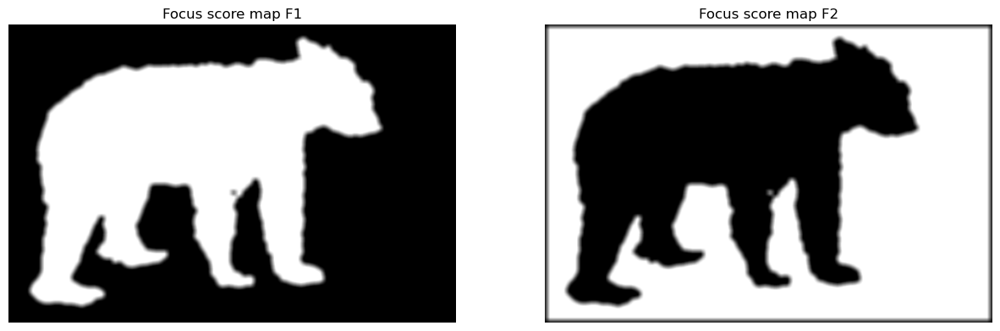

compute_initial_segmentation_maps
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
	W=640, H=427
F1.shape: (427, 640)
F2.shape: (427, 640)
segmentation_maps shape: (2, 427, 640)
	Focus scores shape: (2, 427, 640)
I1 == 0 : 155429
I1 == 0.5 : 21694
I1 == 1 : 96157
I2 == 0 : 96157
I2 == 0.5 : 21694
I2 == 1 : 155429
0.0    155429
1.0     96157
0.5     21694
Name: count, dtype: int64
1.0    155429
0.0     96157
0.5     21694
Name: count, dtype: int64


/tmp/ipykernel_1391/3702499448.py:15: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  print(pd.value_counts(results["initial_segmentation_maps"][0].flatten()))
/tmp/ipykernel_1391/3702499448.py:16: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  print(pd.value_counts(results["initial_segmentation_maps"][1].flatten()))


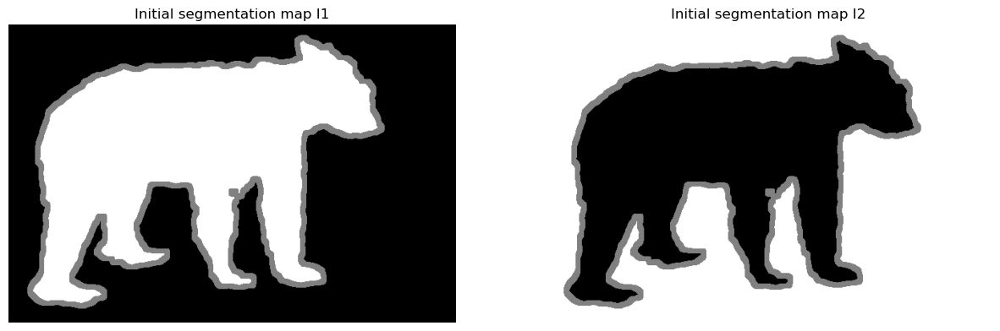

apply_morphology_filter
	Strucuting element size: 3
	Number of iterations: 5
I1 shape: (427, 640)
I2 shape: (427, 640)
M1 shape: (427, 640)
0.0    155539
1.0     95509
0.5     22232
Name: count, dtype: int64
1.0    155539
0.0     95509
0.5     22232
Name: count, dtype: int64


/tmp/ipykernel_1391/3702499448.py:25: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  print(pd.value_counts(results["morphological_segmentation_maps"][0].flatten()))
/tmp/ipykernel_1391/3702499448.py:26: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  print(pd.value_counts(results["morphological_segmentation_maps"][1].flatten()))


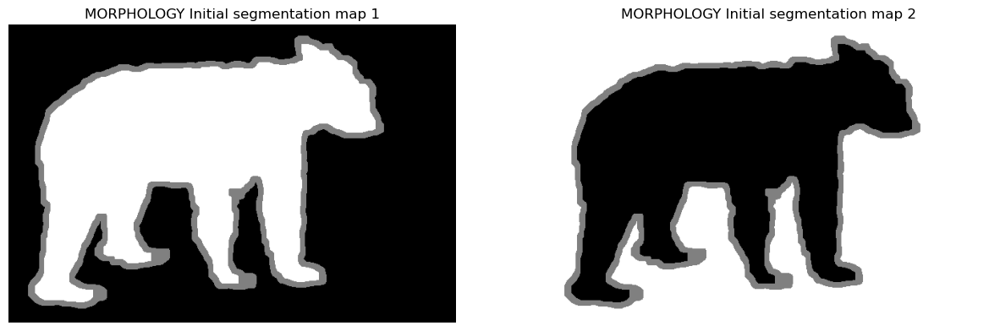

compute_trimap
	W=640, H=427
I1 shape: (427, 640)
I2 shape: (427, 640)
trimap shape: (427, 640)


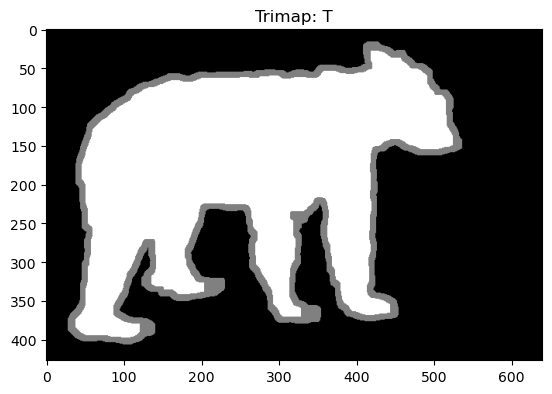

In [221]:
seg_strat = segmentation_strategy(focus_maps=focus_maps, patch_size=8, step_size=1, verbose=True)

## 3.3. Image matting technique for fusion

In [222]:
img = images[0]
trimap = seg_strat["trimap"]

print(np.sum(trimap == 0))
print(np.sum(trimap == 0.5))
print(np.sum(trimap == 1))

output = np.zeros_like(img)

# cv.infoFlow(img, trimap, output)

155539
22232
95509


In [223]:
def image_matting(images, trimap, verbose=False):
    FG, BG = images.copy()
    
    fg_mask = np.where(trimap == 1, 1, 0).astype(np.uint8)
    # ARTIFICIU DE AL NOSTRU
    # fg_mask=morph_close(fg_mask, np.ones((7,7)), 7)
    # print(pd.value_counts(fg_mask.flatten()))
    # bg_mask = np.where(trimap == 0, 1, 0).astype(np.uint8)
    # ARTIFICIU DE AL NOSTRU
    # bg_mask=morph_close(bg_mask, np.ones((7,7)), 7)
    # print(pd.value_counts(bg_mask.flatten()))

    
    # unknown_mask = np.where(trimap == 0.5, 1, 0).astype(np.uint8)
    
    # plot_images(np.array([fg_mask, bg_mask]), ["FG mask", "BG| mask"])
    # plot_images(np.array([fg_mask, unknown_mask]), ["FG mask", "UK mask"])
    
    
    
    NUM_COLOR_CHNS = 3
    
    matting_image = np.zeros_like(images[0])
    
    if verbose:
        print(f"matting_image.shape: {matting_image.shape}")
        print(f"FG.shape: {FG.shape}")
        print(f"BG.shape: {BG.shape}")
    
    rows, cols = fg_mask.shape
    for img in images:
        for row in range(rows):
            for col in range(cols):
                print(f"crnt_row: {row}")
                
                alpha = fg_mask[row, col]
                
                matting_image[row, col, 0] = alpha * FG[row, col, 0] + (1-alpha)* BG[row, col, 0]
                matting_image[row, col, 1] = alpha * FG[row, col, 1] + (1-alpha)* BG[row, col, 1]
                matting_image[row, col, 2] = alpha * FG[row, col, 2] + (1-alpha)* BG[row, col, 2]

    plt.figure()
    plt.imshow(matting_image)
    plt.title("Representation of 1D Gaussian Kernel")
    plt.xlabel("Index")
    plt.ylabel("Kernel Value")
    plt.show()
    
    # bg_mask = np.where(trimap == 0, 1, 0).astype(np.uint8)
    # ARTIFICIU DE AL NOSTRU
    # bg_mask=morph_close(bg_mask, np.ones((7,7)), 7)
    # print(pd.value_counts(bg_mask.flatten()))

    
    # unknown_mask = np.where(trimap == 0.5, 1, 0).astype(np.uint8)
    
    # plot_images(np.array([fg_mask, bg_mask]), ["FG mask", "BG| mask"])
    # plot_images(np.array([fg_mask, unknown_mask]), ["FG mask", "UK mask"])
    
    pass

matting_image.shape: (427, 640, 3)
FG.shape: (427, 640, 3)
BG.shape: (427, 640, 3)
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_row: 0
crnt_

crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_row: 225
crnt_r

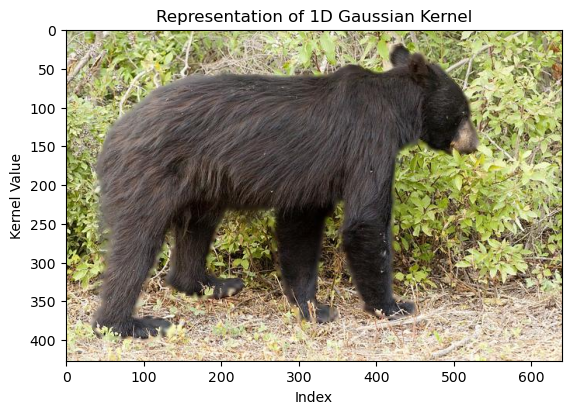

In [224]:
image_matting(images, trimap, verbose=True)

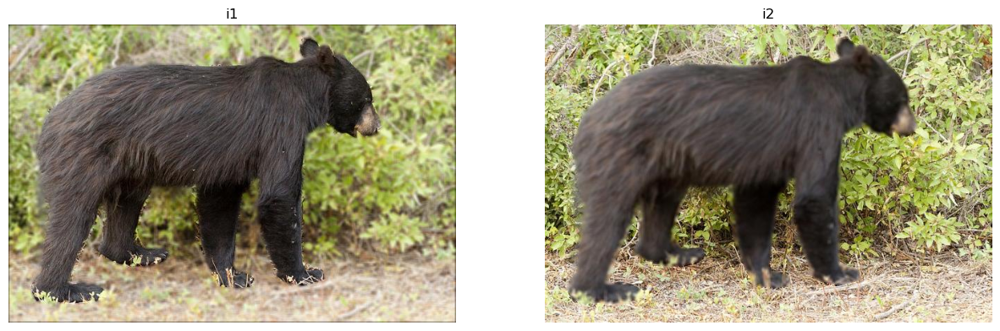

In [226]:
plot_images(images, ["i1", "i2"])

In [225]:
assert 1== 2, "Code stops here"

AssertionError: Code stops here

compute_focus_scores
Input image dimensions: H x W = 520 x 520
Number of patches: 263169
Theoretical number of patches: (H-n+1)x(W-n+1) = 513x513 = 263169


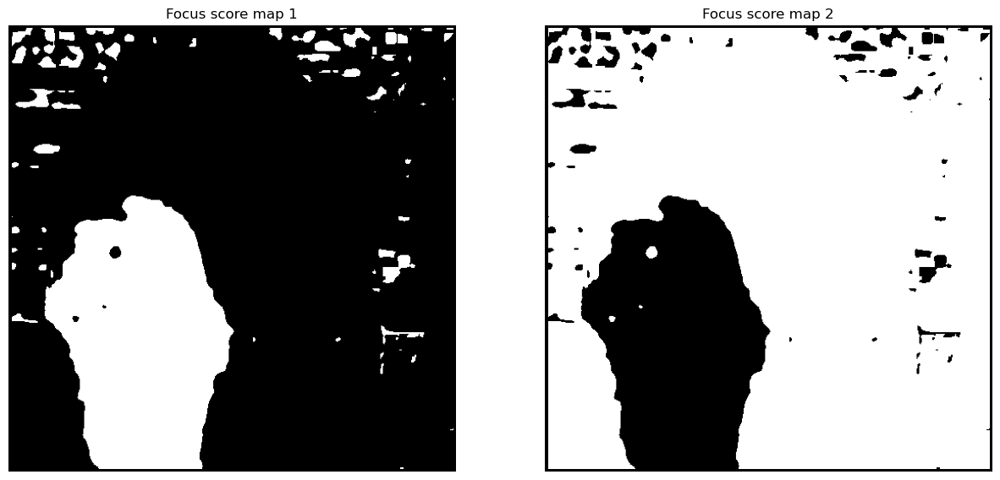

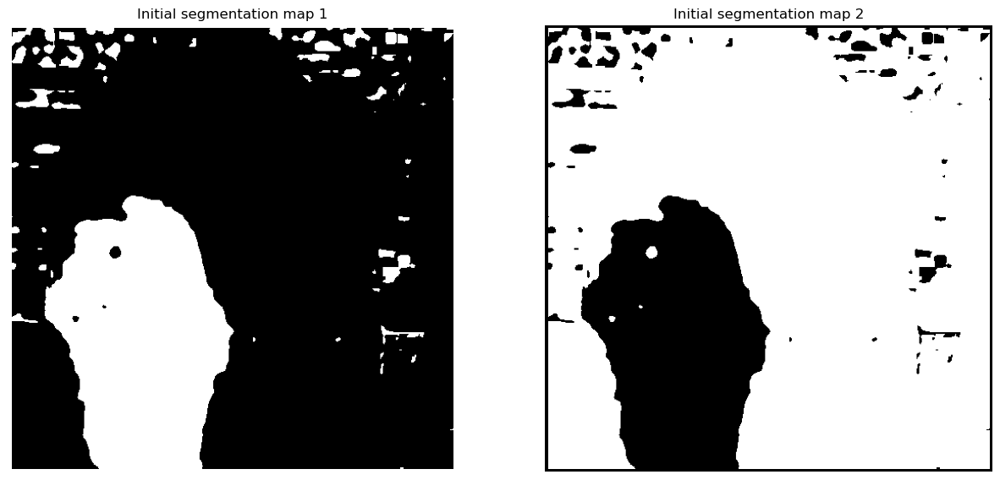

In [ ]:
test_images = segmentation_strategy(focus_maps=focus_maps, patch_size=8, step_size=1)


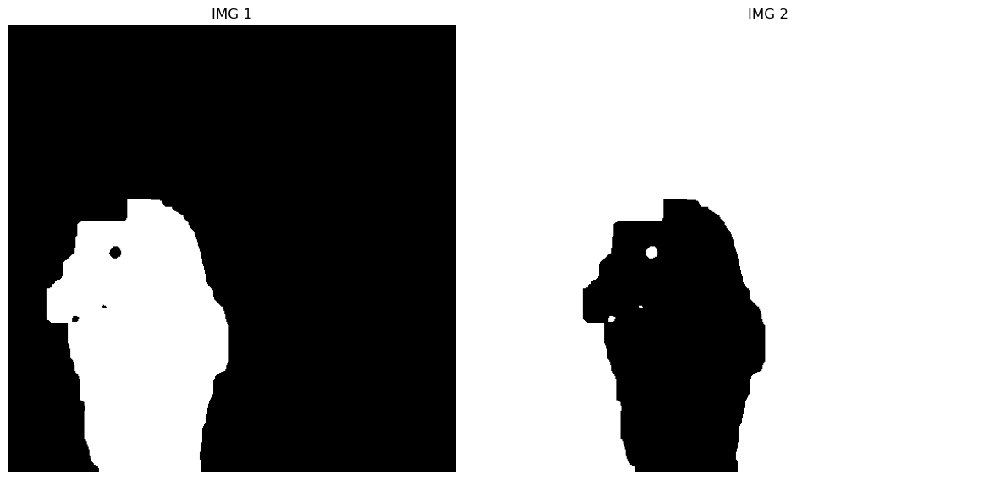

## TESTING AREA

In [ ]:
grayscale_imgages = np.array([cv.cvtColor(img, cv.COLOR_BGR2GRAY) for img in images])

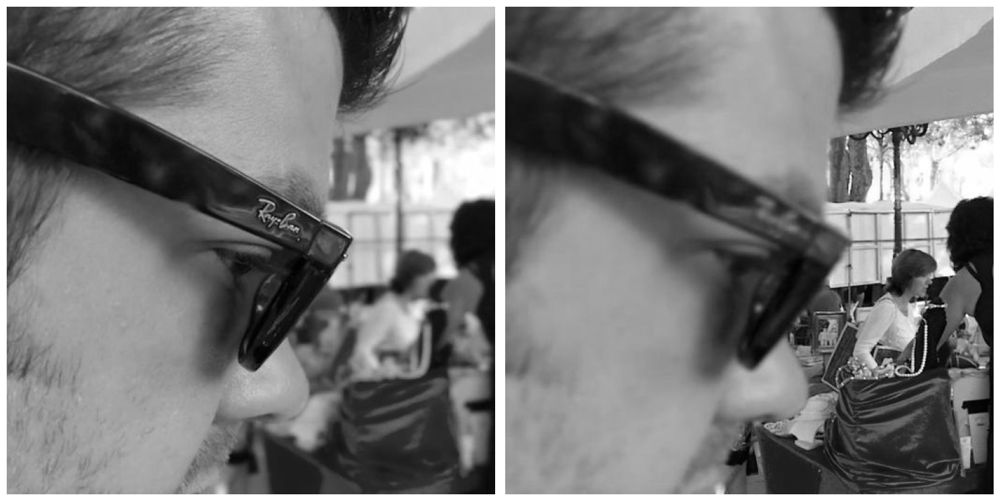

In [ ]:
plot_images(grayscale_imgages)

In [ ]:
grayscale_imgages.shape

(2, 520, 520)

# Algorithm implementation

## Sum of the Gaussian-based modified Laplacian

TODO: describe what a kernel is, gaussian distribution and the visualizations below
TODO: add .ini file with hyperparameters

In [ ]:
def convolution_iterator(img: np.ndarray, kernel, verbose=False):
    # img : 2D image -> W x H
    height_img, width_img = img.shape
    height_kernel, width_kernel = kernel
    
    if verbose:
        print(f"kernel_shape: {kernel.shape}")
        print(f"img shape: {img.shape}")

    # Loop through each pixel in the image skipping the outer edges of the image
    for y in range(height_kernel // 2, 
                   height_img - height_kernel // 2 - 1):
        for x in range(width_kernel // 2, 
                       width_img - width_kernel // 2 - 1):
            window = img[
                y - height_kernel // 2 : y + height_kernel // 2 + 1,
                x - width_kernel // 2 : x + width_kernel // 2 + 1,
            ]
            
            yield (y, x, window)


Compute the ML to extract edge information without loosing information when terms might cancel each other
- Based on reference [5] from our paper, the ML is computed over a window with size=3

In [ ]:
kernel_size = 7
padding = (kernel_size - 1) // 2

def pad_images(images: np.ndarray, padding: int, border=cv.BORDER_CONSTANT):
    """Takes a list of images and pads them with zeros

    Args:
        images (np.ndarray): list containing images to be padded as numpy arrays
        padding (int): padding to be applied to each image
    
    Returns:
        np.ndarray: padded images
    """
    padded_images = []
    
    for idx, img in enumerate(images):
        replicate = cv.copyMakeBorder(img,padding,padding,padding,padding, border,value=0)
        padded_images.append(replicate)
        
    return np.array(padded_images)

In [ ]:
padded_images = pad_images(images, padding, cv.BORDER_CONSTANT)

In [ ]:
images.shape, padded_images.shape

((2, 520, 520, 3), (2, 526, 526, 3))

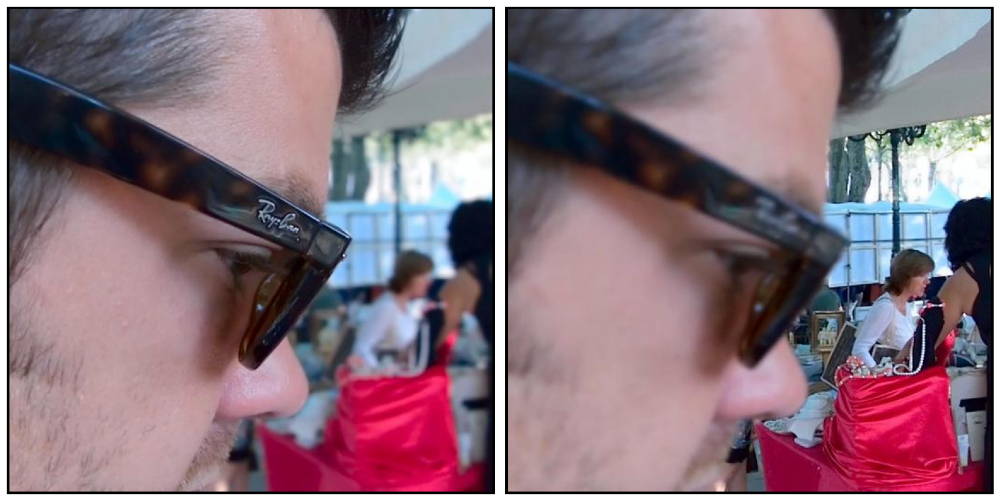

In [ ]:
plot_images(padded_images)

In [ ]:
def ML(images, step_size=1):
    # TODO: check that the step size wont cause the window to go out of bounds
    grayscale_imgages = np.array([cv.cvtColor(img, cv.COLOR_BGR2GRAY) for img in images])
    
    
    ml_images = []
    for idx, img in enumerate(grayscale_imgages):
        crnt_ml = np.zeros_like(img)
        for y, x, window in convolution_iterator(img, (7,7)):
            crnt_ml[y, x] = np.abs(2*img[y,x] - img[y-step_size,x] - img[y+step_size,x]) + \
                                        np.abs(2*img[y,x] - img[y,x-step_size] - img[y,x+step_size])
        ml_images.append(crnt_ml)
    return np.array(ml_images)

In [ ]:
ml_images = ML(padded_images)
ml_images.shape

(2, 526, 526)

In [ ]:
padded_images.shape,  images.shape, ml_images.shape

((2, 526, 526, 3), (2, 520, 520, 3), (2, 526, 526))

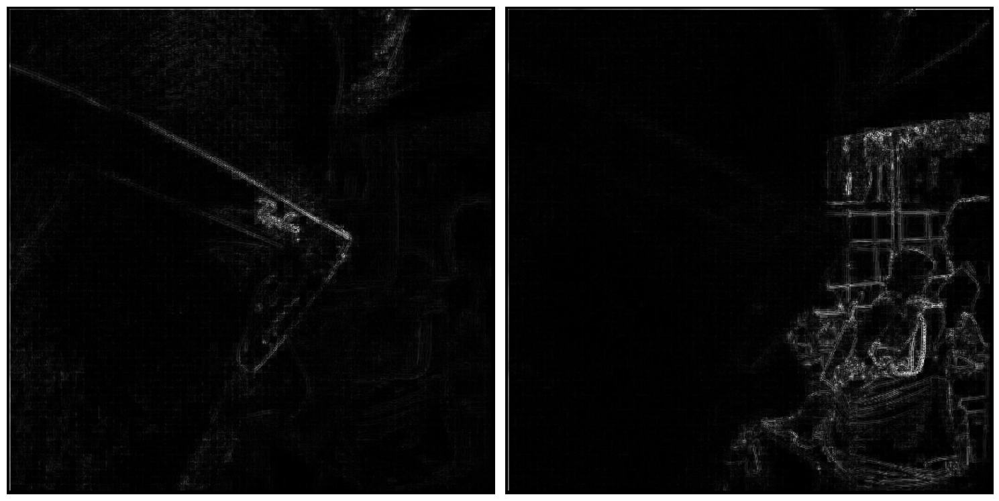

In [ ]:
# View result of the ML
COLOR_CHN = 1
plot_images(ml_images)
# plot_images(ml_images[:, :, :, COLOR_CHN])

In [ ]:
def SGML(ml_images, window_size=7, crop_size=padding):
    sigma=2
    threshold=0
    
    gaussian_kernel_1D = cv.getGaussianKernel(window_size, sigma)
    gaussian_kernel_2d = np.outer(gaussian_kernel_1D, gaussian_kernel_1D.transpose())
    
    sgml_images = []
    for idx, img in enumerate(ml_images):
        crnt_img = np.zeros_like(img)
        for y, x, window in convolution_iterator(img, gaussian_kernel_2d.shape):
            crnt_step = (window * gaussian_kernel_2d)
                
            # ml_img_color_chn[y, x] = np.sum(np.array(crnt_step > threshold))
            crnt_img[y, x] = np.sum(crnt_step)

        # add the cropped color channel to the current image
        sgml_images.append(crnt_img[crop_size:-crop_size, crop_size:-crop_size])
        
    return np.array(sgml_images)
    

In [ ]:
focus_maps = SGML(ml_images)

In [ ]:
focus_maps.shape, images.shape, focus_maps.min(), focus_maps.max()

((2, 520, 520), (2, 520, 520, 3), 0, 138)

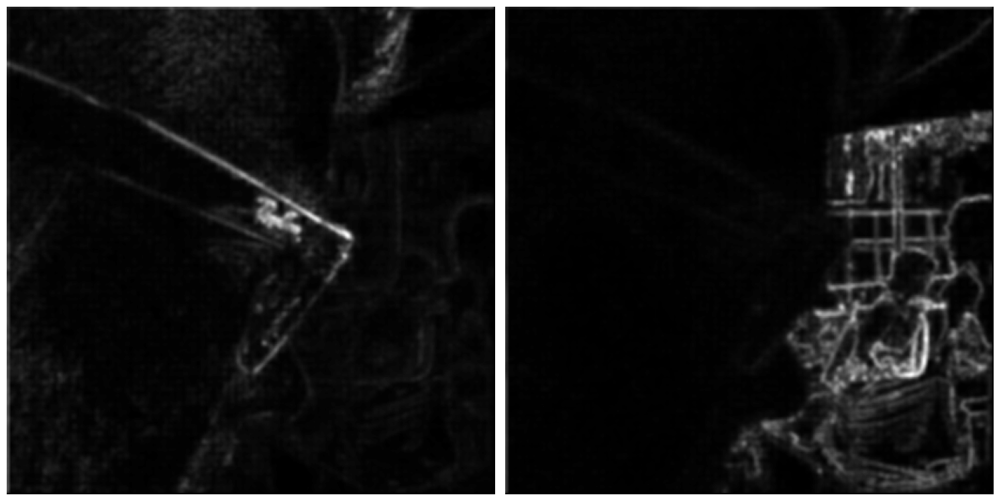

In [ ]:
# View result of the ML
COLOR_CHN = 1
plot_images(focus_maps)

In [ ]:
assert 1 == 2, "Error: this is a test"

AssertionError: Error: this is a test

## Strategy of initial segmentation

In [ ]:
def segmentation_strategy(sgml_maps, patch_size=8, step_size=1):
    patch = np.ones((patch_size,patch_size))
    height_img, width_img = sgml_maps[0].shape
    
    S1, S2 = sgml_maps
    
    focus_socre_maps = np.zeros_like(sgml_maps)
    F1, F2 = focus_socre_maps
    
    # Sliding window over the image
    for y in range(patch_size // 2, 
                   height_img - patch_size // 2 - 1,
                   step_size):
        for x in range(patch_size // 2, 
                       width_img - patch_size // 2 - 1,
                       step_size):
            window1 = S1[
                y - patch_size // 2 : y + patch_size // 2 + 1,
                x - patch_size // 2 : x + patch_size // 2 + 1,
            ]
            window2 = S2[
                y - patch_size // 2 : y + patch_size // 2 + 1,
                x - patch_size // 2 : x + patch_size // 2 + 1,
            ]
            
            k1 = np.sum(window1)
            k2 = np.sum(window2)
            
            if k1 > k2:
                F1[y, x] += 1
            else:
                F2[y, x] += 1
                
    print(f"F1 shape: {F1.shape}")
    print(f"F2 shape: {F2.shape}")
    
    segmentation_maps = np.ones_like(focus_socre_maps) * 0.5
    print(f"segmentation_maps.shape {segmentation_maps.shape}")
    print(f"F1.shape[0] {F1.shape[0]}")
    print(f"F1.shape[1] {F1.shape[1]}")
    
    I1_IDX, I2_IDX = range(2)
    
    
    for y in range(F1.shape[0]): # rows
        for x in range(F1.shape[1]): # cols
            if F2[y, x] == 0:
                segmentation_maps[I1_IDX, y, x] = 1
                segmentation_maps[I2_IDX, y, x] = 0
            elif F1[y, x] == 0:
                segmentation_maps[I1_IDX, y, x] = 0
                segmentation_maps[I2_IDX, y, x] = 1
                
    return segmentation_maps    

In [ ]:
segmentation_maps = segmentation_strategy(focus_maps)

F1 shape: (520, 520)
F2 shape: (520, 520)
segmentation_maps.shape (2, 520, 520)
F1.shape[0] 520
F1.shape[1] 520


In [ ]:
segmentation_maps.shape

(2, 520, 520)

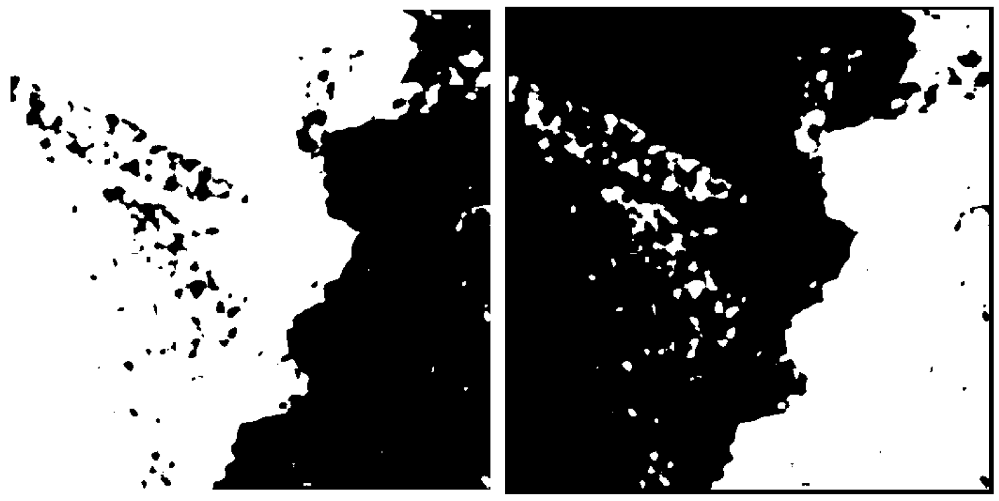

In [ ]:
plot_images(segmentation_maps)

In [ ]:
def open_close_operation(segmentation_maps):
    T=np.ones_like(segmentation_maps.shape[1:])
    

In [ ]:
crnt_img = red_angle
for k in range(1,8):
    # compute crnt treshold
    placeHolder = np.zeros_like(crnt_img.shape)
    
    # ar fi nested fors
    # mergi pe linii si coloane si pui in placeholder si compari crn img cu threshold -> rez in placeholder
    
    # crnt_img = placeHolder    
    
    
    

In [ ]:
assert 1 == 2, "Error: this is a test"

AssertionError: Error: this is a test

## Image mating technique for fusion

In [ ]:
assert 1 == 2, "Error: this is a test"

In [ ]:
a=list(range(10))
a

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

In [ ]:
# OFFICIAL CV2 IMPLEMENTATION
kernel_size = 7
sigma = 2 
gaussian_kernel_1D = cv2.getGaussianKernel(kernel_size, sigma)
gaussian_kernel_2d = np.outer(gaussian_kernel_1D, gaussian_kernel_1D.transpose())

print(f"gaussian_kernel_1D shape: {gaussian_kernel_1D.shape}")
print(f"gaussian_kernel_2d shape: {gaussian_kernel_2d.shape}")

NameError: name 'cv2' is not defined

In [ ]:
def plot_kernel_1D(kernel):
    plt.figure()
    plt.plot(kernel)
    plt.xlabel('Index')
    plt.ylabel('Value')
    plt.title('Representation of 1D Kernel')
    plt.show()
    
def plot_kernel_2D(kernel):
    # Create the x and y coordinate arrays
    x = np.arange(kernel.shape[0])
    y = np.arange(kernel.shape[1])
    x, y = np.meshgrid(x, y)

    # Create the figure
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Plot the surface
    ax.plot_surface(x, y, kernel, cmap='viridis')

    # Labels and title
    ax.set_xlabel('X axis')
    ax.set_ylabel('Y axis')
    ax.set_zlabel('Kernel Value')
    ax.set_title('3D Representation of 2D Kernel')

    # Show the plot
    plt.show()    

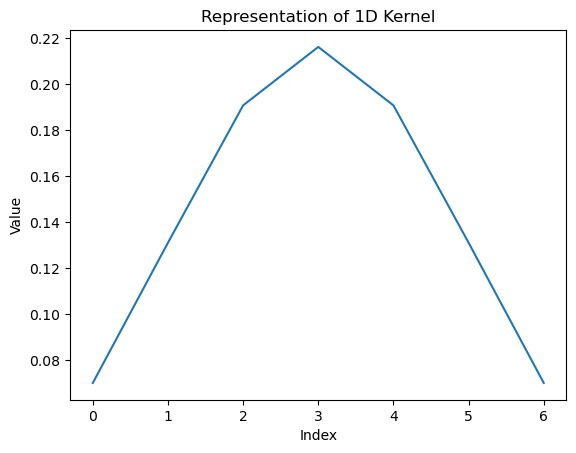

In [ ]:
plot_kernel_1D(gaussian_kernel_1D)

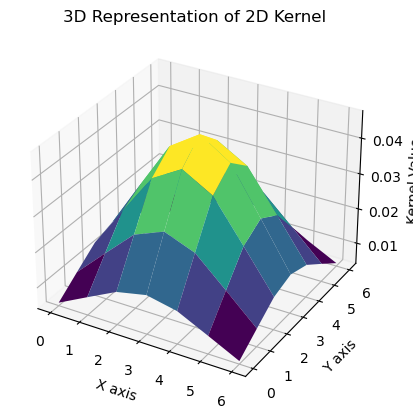

In [ ]:
plot_kernel_2D(gaussian_kernel_2d)

In [ ]:
def ML(img, s=1):
    
    pass

In [ ]:
def SGML(img=None, sigma=2, kernel_size=7):
    """Applies the Sum of the Gaussian-based modified Laplacian (SGML) filter to the input image

    Args:
        img (np.ndarray): image to be filtered
        sigma (int, optional): standard deviation of the Gaussian Kernel. Defaults to 2.
        r (int, optional): kernel size. Defaults to 7.

    Returns:
        np.ndarray: filtered image
    """
    assert kernel_size%2 == 1 and kernel_size > 1, "kernel_size must be an odd number greater than 1"
    assert sigma > 0, "sigma must be greater than 0"
    

# Paper implementation of algorithm: image focus score

## References:
- https://github.com/OmarMSaad/1D-Modified-Laplacian-of-Gaussian-Filter-for-Smoothing-and-Denoising-/tree/master